In [1]:
library(tidyverse)
library(tidymodels)
library(repr)
library(readxl)


── Attaching packages ─────────────────────────────────────── tidyverse 1.3.2 ──
✔ ggplot2 3.4.2     ✔ purrr   1.0.1
✔ tibble  3.2.1     ✔ dplyr   1.1.1
✔ tidyr   1.3.0     ✔ stringr 1.5.0
✔ readr   2.1.3     ✔ forcats 0.5.2
── Conflicts ────────────────────────────────────────── tidyverse_conflicts() ──
✖ dplyr::filter() masks stats::filter()
✖ dplyr::lag()    masks stats::lag()
── Attaching packages ────────────────────────────────────── tidymodels 1.0.0 ──

✔ broom        1.0.2     ✔ rsample      1.1.1
✔ dials        1.1.0     ✔ tune         1.0.1
✔ infer        1.0.4     ✔ workflows    1.1.2
✔ modeldata    1.0.1     ✔ workflowsets 1.0.0
✔ parsnip      1.0.3     ✔ yardstick    1.1.0
✔ recipes      1.0.4     

── Conflicts ───────────────────────────────────────── tidymodels_conflicts() ──
✖ scales::discard() masks purrr::discard()
✖ dplyr::filter()   masks stats::filter()
✖ recipes::fixed()  masks stringr::fixed()
✖ dplyr::lag()      masks stats::lag()
✖ yardstick::spec() masks read

In [2]:
Census_income <- read_csv(file = "/home/jovyan/DSCI_Project_Group31/Census_income/adult.data", col_names = 
                          c("age", "workclass","fnlwgt","education","education_num","marital_status",
                            "occupation","relationship","race","sex","capital_gain","capital_loss",
                            "hours_per_week","native_country", "income_lvl"))
glimpse(Census_income)
Census_income

Rows: 32561 Columns: 15
── Column specification ────────────────────────────────────────────────────────
Delimiter: ","
chr (9): workclass, education, marital_status, occupation, relationship, rac...
dbl (6): age, fnlwgt, education_num, capital_gain, capital_loss, hours_per_week

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.


Rows: 32,561
Columns: 15
$ age            <dbl> 39, 50, 38, 53, 28, 37, 49, 52, 31, 42, 37, 30, 23, 32,…
$ workclass      <chr> "State-gov", "Self-emp-not-inc", "Private", "Private", …
$ fnlwgt         <dbl> 77516, 83311, 215646, 234721, 338409, 284582, 160187, 2…
$ education      <chr> "Bachelors", "Bachelors", "HS-grad", "11th", "Bachelors…
$ education_num  <dbl> 13, 13, 9, 7, 13, 14, 5, 9, 14, 13, 10, 13, 13, 12, 11,…
$ marital_status <chr> "Never-married", "Married-civ-spouse", "Divorced", "Mar…
$ occupation     <chr> "Adm-clerical", "Exec-managerial", "Handlers-cleaners",…
$ relationship   <chr> "Not-in-family", "Husband", "Not-in-family", "Husband",…
$ race           <chr> "White", "White", "White", "Black", "Black", "White", "…
$ sex            <chr> "Male", "Male", "Male", "Male", "Female", "Female", "Fe…
$ capital_gain   <dbl> 2174, 0, 0, 0, 0, 0, 0, 0, 14084, 5178, 0, 0, 0, 0, 0, …
$ capital_loss   <dbl> 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0…
$ hours_per_wee

age,workclass,fnlwgt,education,education_num,marital_status,occupation,relationship,race,sex,capital_gain,capital_loss,hours_per_week,native_country,income_lvl
<dbl>,<chr>,<dbl>,<chr>,<dbl>,<chr>,<chr>,<chr>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<chr>,<chr>
39,State-gov,77516,Bachelors,13,Never-married,Adm-clerical,Not-in-family,White,Male,2174,0,40,United-States,<=50K
50,Self-emp-not-inc,83311,Bachelors,13,Married-civ-spouse,Exec-managerial,Husband,White,Male,0,0,13,United-States,<=50K
38,Private,215646,HS-grad,9,Divorced,Handlers-cleaners,Not-in-family,White,Male,0,0,40,United-States,<=50K
53,Private,234721,11th,7,Married-civ-spouse,Handlers-cleaners,Husband,Black,Male,0,0,40,United-States,<=50K
28,Private,338409,Bachelors,13,Married-civ-spouse,Prof-specialty,Wife,Black,Female,0,0,40,Cuba,<=50K
37,Private,284582,Masters,14,Married-civ-spouse,Exec-managerial,Wife,White,Female,0,0,40,United-States,<=50K
49,Private,160187,9th,5,Married-spouse-absent,Other-service,Not-in-family,Black,Female,0,0,16,Jamaica,<=50K
52,Self-emp-not-inc,209642,HS-grad,9,Married-civ-spouse,Exec-managerial,Husband,White,Male,0,0,45,United-States,>50K
31,Private,45781,Masters,14,Never-married,Prof-specialty,Not-in-family,White,Female,14084,0,50,United-States,>50K


In [3]:
Census_income_filtered <- select(Census_income,age,education_num,income_lvl)
Census_income_filtered

age,education_num,income_lvl
<dbl>,<dbl>,<chr>
39,13,<=50K
50,13,<=50K
38,9,<=50K
53,7,<=50K
28,13,<=50K
37,14,<=50K
49,5,<=50K
52,9,>50K
31,14,>50K


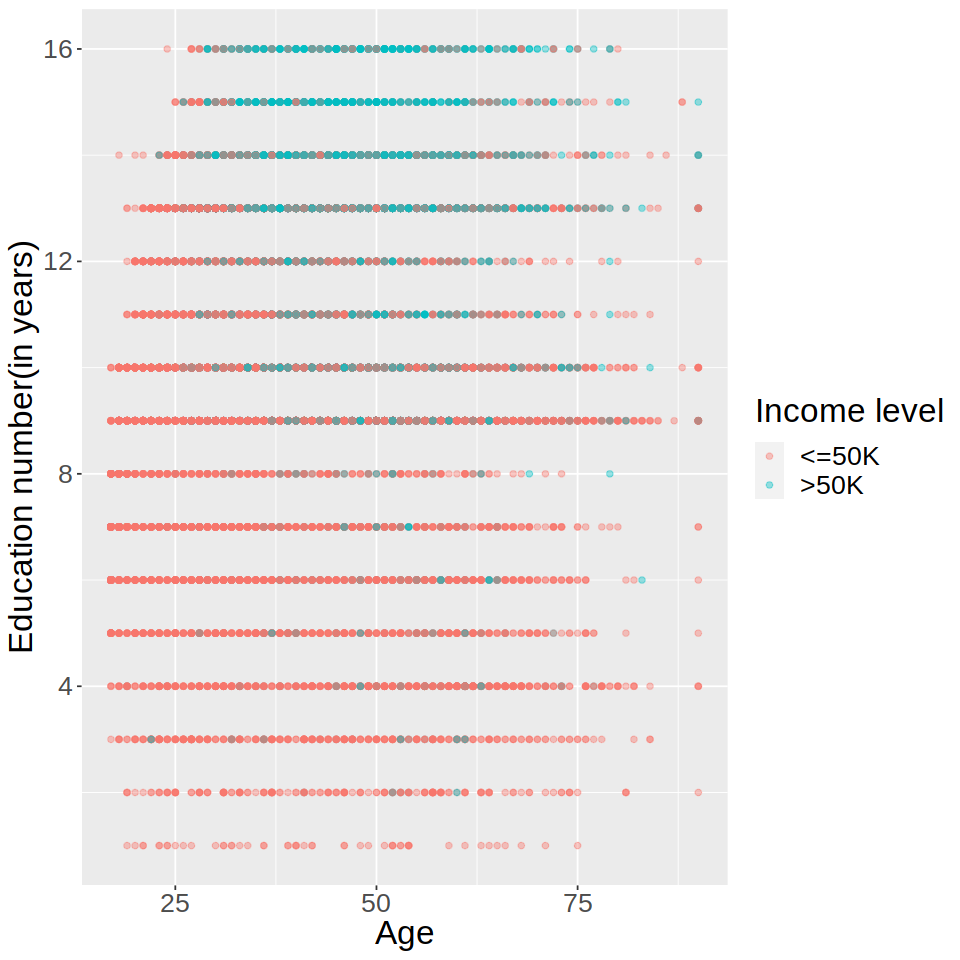

In [4]:
options(repr.plot.width = 8, repr.plot.height = 8) 

Census_income_plot <- Census_income_filtered|>
                      ggplot(aes(x = age, y = education_num, colour = income_lvl)) + 
                      geom_point(alpha = 0.4) + 
                      labs(x = "Age", y = "Education number(in years)", colour = "Income level")+
                      theme(text = element_text(size = 20))       

Census_income_plot

In [5]:
Census_income_filtered <- Census_income_filtered |>
                          mutate(income_lvl = as_factor(income_lvl)) |>
                          mutate(income_lvl = fct_recode(income_lvl,  "Less_or_equal_to_50K" = "<=50K", "More_than_50K" = ">50K"))
Census_income_filtered

age,education_num,income_lvl
<dbl>,<dbl>,<fct>
39,13,Less_or_equal_to_50K
50,13,Less_or_equal_to_50K
38,9,Less_or_equal_to_50K
53,7,Less_or_equal_to_50K
28,13,Less_or_equal_to_50K
37,14,Less_or_equal_to_50K
49,5,Less_or_equal_to_50K
52,9,More_than_50K
31,14,More_than_50K


In [6]:
num_obs <- nrow(Census_income_filtered)
           Census_income_filtered |>
           group_by(income_lvl) |>
           summarize(count = n(),percentage = n() / num_obs * 100)

income_lvl,count,percentage
<fct>,<int>,<dbl>
Less_or_equal_to_50K,24720,75.91904
More_than_50K,7841,24.08096


In [14]:
Census_income_split <- initial_split(Census_income_filtered, prop = 0.75, strata = income_lvl)  
Census_income_train <- training(Census_income_split)   
Census_income_test <- testing(Census_income_split)

Census_income_train
Census_income_test

age,education_num,income_lvl
<dbl>,<dbl>,<fct>
53,7,Less_or_equal_to_50K
37,14,Less_or_equal_to_50K
49,5,Less_or_equal_to_50K
23,13,Less_or_equal_to_50K
32,12,Less_or_equal_to_50K
34,4,Less_or_equal_to_50K
25,9,Less_or_equal_to_50K
32,9,Less_or_equal_to_50K
54,9,Less_or_equal_to_50K


age,education_num,income_lvl
<dbl>,<dbl>,<fct>
39,13,Less_or_equal_to_50K
50,13,Less_or_equal_to_50K
38,9,Less_or_equal_to_50K
28,13,Less_or_equal_to_50K
40,11,More_than_50K
38,7,Less_or_equal_to_50K
56,13,More_than_50K
22,10,Less_or_equal_to_50K
19,9,Less_or_equal_to_50K


In [15]:
set.seed(9999) 
Census_income_recipe <- recipe(income_lvl ~ age + education_num, data = Census_income_train) |>
                        step_scale(all_predictors()) |>
                        step_center(all_predictors())|>
                        prep()
Census_income_recipe
income_data_scaled <- Census_income_recipe |>   
                            bake(Census_income_train)

income_data_scaled

Recipe

Inputs:

      role #variables
   outcome          1
 predictor          2

Training data contained 24420 data points and no missing data.

Operations:

Scaling for age, education_num [trained]
Centering for age, education_num [trained]

age,education_num,income_lvl
<dbl>,<dbl>,<fct>
1.05541652,-1.20611287,Less_or_equal_to_50K
-0.11734187,1.52650034,Less_or_equal_to_50K
0.76222692,-1.98685951,Less_or_equal_to_50K
-1.14350547,1.13612703,Less_or_equal_to_50K
-0.48382887,0.74575371,Less_or_equal_to_50K
-0.33723407,-2.37723282,Less_or_equal_to_50K
-0.99691067,-0.42536624,Less_or_equal_to_50K
-0.48382887,-0.42536624,Less_or_equal_to_50K
1.12871392,-0.42536624,Less_or_equal_to_50K


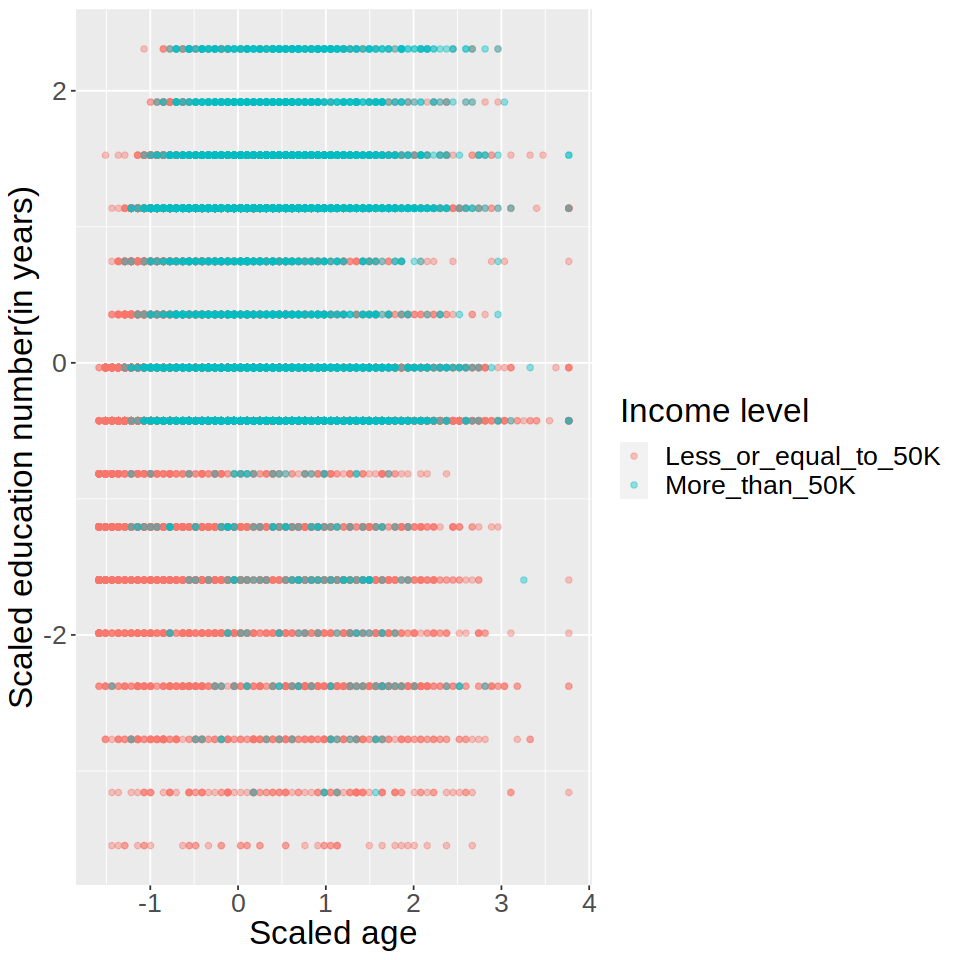

In [18]:
options(repr.plot.width = 8, repr.plot.height = 8) 

income_scaled_plot <- income_data_scaled|>
                      ggplot(aes(x = age, y = education_num, colour = income_lvl)) + 
                      geom_point(alpha = 0.4) + 
                      labs(x = "Scaled age", y = "Scaled education number(in years)", colour = "Income level")+
                      theme(text = element_text(size = 20))       

income_scaled_plot